In [1]:
%load_ext autoreload
%autoreload 2
import os
import glob
import h5py
import numpy as np
import matplotlib.pyplot as plt
import torch
from torchvision import transforms
from torch.utils.data import DataLoader

from m3util.viz.style import set_style
from m3util.viz.layout import layout_fig
from dl_utils.utils.utils import list_to_dict
from dl_utils.utils.dataset import viz_dataloader, split_train_valid, hdf5_dataset
from dl_utils.training.build_model import resnet50_, fpn_resnet50_classification, xcit_small
from dl_utils.analysis.loss_landscape import compute_loss_landscape, visualize_loss_landscape, visualize_loss_landscape_interactive_plotly
set_style("printing")

printing set for seaborn


/home/yichen/Understanding-Experimental-Images-by-Identifying-Symmetries-with-Deep-Learning/src/m3learning-util/src/m3util/viz/layout.py:255: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  fig.subplots_adjust(wspace=wspace, hspace=hspace)


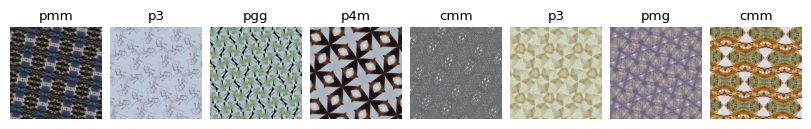

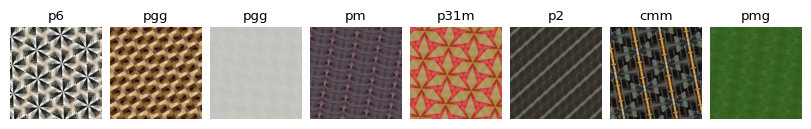

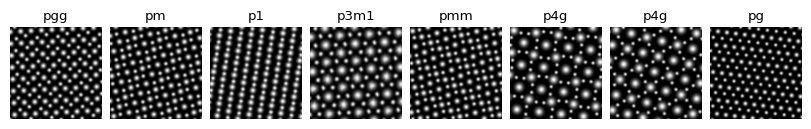

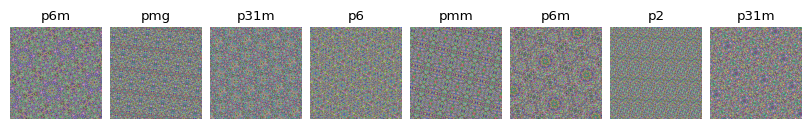

In [2]:
symmetry_classes = ['p1', 'p2', 'pm', 'pg', 'cm', 'pmm', 'pmg', 'pgg', 'cmm', 'p4', 'p4m', 'p4g', 'p3', 'p3m1', 'p31m', 'p6', 'p6m']
label_converter = list_to_dict(symmetry_classes)
bs = 64

# imagenet
imagenet_ds = hdf5_dataset('../../datasets/imagenet_v5_rot_10m.h5', folder='train', transform=transforms.ToTensor())
train_ds, valid_ds = split_train_valid(imagenet_ds, 0.8)
train_dl = DataLoader(train_ds, batch_size=bs, shuffle=True, num_workers=4)
viz_dataloader(train_dl, label_converter=label_converter, title='imagenet - train')
valid_dl = DataLoader(valid_ds, batch_size=bs, shuffle=False, num_workers=4)
viz_dataloader(valid_dl, label_converter=label_converter, title='imagenet - valid')

# atom
atom_ds = hdf5_dataset('../../datasets/atom_v5_rot_200k.h5', folder='atom', transform=transforms.ToTensor())
atom_dl = DataLoader(atom_ds, batch_size=bs, shuffle=False, num_workers=4)
viz_dataloader(atom_dl, label_converter=label_converter, title='atom - cv')

# noise
noise_ds = hdf5_dataset('../../datasets/noise_v5_rot_100k.h5', folder='noise', transform=transforms.ToTensor())
noise_dl = DataLoader(noise_ds, batch_size=bs, shuffle=False, num_workers=4)
viz_dataloader(noise_dl, label_converter=label_converter, title='noise - cv')

In [3]:
device = torch.device('cuda:7')
model = xcit_small(in_channels=3, n_classes=len(symmetry_classes))
model.load_state_dict(torch.load('../../models/XCiT/09302024-XCiT-dataset_v5_size-10m/model_epoch_20.pth', weights_only=True, map_location='cpu'))
model.eval()

Xcit(
  (patch_embed): ConvPatchEmbed(
    (proj): Sequential(
      (0): Sequential(
        (0): Conv2d(3, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): GELU(approximate='none')
      (2): Sequential(
        (0): Conv2d(96, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (3): GELU(approximate='none')
      (4): Sequential(
        (0): Conv2d(192, 384, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
  )
  (pos_embed): PositionalEncodingFourier(
    (token_projection): Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1))
  )
  (pos_drop): Dropout(p=0.0, inplace=False)
  (blocks): ModuleList(
    (0-11): 12 x 

In [4]:
# Step 1: Compute loss landscape
X, Y, loss_values = compute_loss_landscape(model, train_dl, grid_size=50, use_batch=True, subset_ratio=1e-6, device=device)
np.savez("loss_landscape-XCiT-ImageNetTrainBatch-50*50grid.npz", X=X, Y=Y, loss_values=loss_values)

X, Y, loss_values = np.load("../../results/loss_landscape/loss_landscape-XCiT-ImageNetTrain1e-6p-50*50grid.npz", allow_pickle=True).values()
visualize_loss_landscape_interactive_plotly(X, Y, loss_values)

Computing Loss Landscape: 100%|██████████| 2500/2500 [19:12<00:00,  2.17it/s]


In [5]:
X, Y, loss_values = compute_loss_landscape(model, valid_dl, grid_size=50, use_batch=True, subset_ratio=1e-4, device=device)
np.savez("../../results/loss_landscape/loss_landscape-XCiT-ImageNetValidBatch-50*50grid.npz", X=X, Y=Y, loss_values=loss_values)

Computing Loss Landscape: 100%|██████████| 2500/2500 [18:06<00:00,  2.30it/s]


In [ ]:
X, Y, loss_values = np.load("../../results/loss_landscape/loss_landscape-XCiT-ImageNetValidBatch-50*50grid.npz", allow_pickle=True).values()
visualize_loss_landscape_interactive_plotly(X, Y, loss_values)

In [ ]:
X, Y, loss_values = compute_loss_landscape(model, atom_dl, grid_size=50, use_batch=False, subset_ratio=1e-1, device=device)
np.savez("../../results/loss_landscape/loss_landscape-XCiT-NoiseBatch-50*50grid.npz", X=X, Y=Y, loss_values=loss_values)

Computing Loss Landscape:   3%|▎         | 82/2500 [23:15:46<674:26:44, 1004.14s/it]

In [ ]:
X, Y, loss_values = np.load("../../results/loss_landscape/loss_landscape-XCiT-NoiseBatch-50*50grid.npz", allow_pickle=True).values()
visualize_loss_landscape_interactive_plotly(X, Y, loss_values)

In [ ]:
X, Y, loss_values = compute_loss_landscape(model, noise_dl, grid_size=50, use_batch=False, subset_ratio=1e-1, device=device)
np.savez("../../results/loss_landscape/loss_landscape-XCiT-AtomBatch-50*50grid.npz", X=X, Y=Y, loss_values=loss_values)

In [ ]:
X, Y, loss_values = np.load("../../results/loss_landscape/loss_landscape-XCiT-AtomBatch-50*50grid.npz", allow_pickle=True).values()
visualize_loss_landscape_interactive_plotly(X, Y, loss_values)

In [3]:
X, Y, loss_values = np.load("../../results/loss_landscape/loss_landscape-XCiT-ImageNetTrain1e-6p-50*50grid.npz", allow_pickle=True).values()
visualize_loss_landscape_interactive_plotly(X, Y, loss_values)

In [3]:
device = torch.device('cuda:6')
model = xcit_small(in_channels=3, n_classes=len(symmetry_classes))
model.load_state_dict(torch.load('../../models/XCiT/09302024-XCiT-dataset_v5_size-10m/model_epoch_20.pth', weights_only=True, map_location='cpu'))
model.eval()

Xcit(
  (patch_embed): ConvPatchEmbed(
    (proj): Sequential(
      (0): Sequential(
        (0): Conv2d(3, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): GELU(approximate='none')
      (2): Sequential(
        (0): Conv2d(96, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (3): GELU(approximate='none')
      (4): Sequential(
        (0): Conv2d(192, 384, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
  )
  (pos_embed): PositionalEncodingFourier(
    (token_projection): Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1))
  )
  (pos_drop): Dropout(p=0.0, inplace=False)
  (blocks): ModuleList(
    (0-11): 12 x 

Computing Loss Landscape: 100%|██████████| 50/50 [18:53<00:00, 22.67s/it]


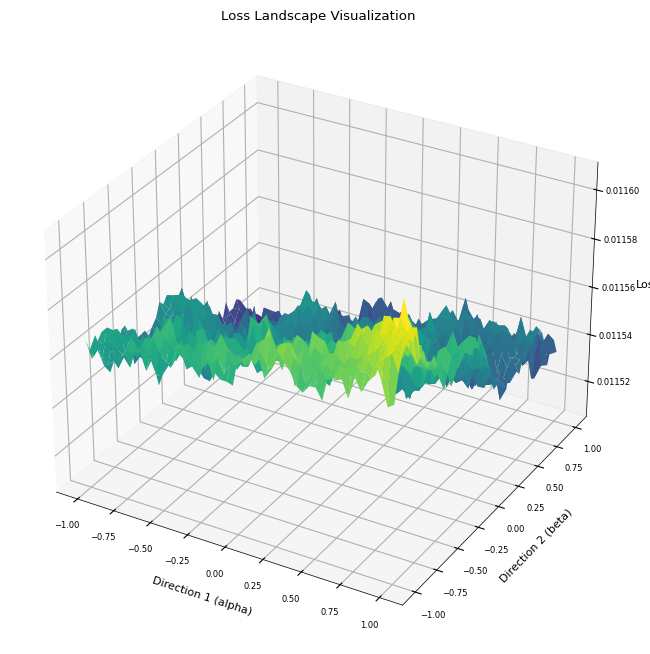

In [4]:
# Compute loss landscape (fast using a single batch)
compute_loss_landscape(model, train_dl, grid_size=50, use_batch=True, device=device)

In [5]:
compute_loss_landscape(model, valid_dl, grid_size=50, use_batch=True, device=device)

Computing Loss Landscape: 100%|██████████| 50/50 [18:43<00:00, 22.46s/it]


(array([[-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        ...,
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ]]),
 array([[-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-0.95918367, -0.95918367, -0.95918367, ..., -0.95918367,
         -0.95918367, -0.95918367],
        [-0.91836735, -0.91836735, -0.91836735, ..., -0.91836735,
         -0.91836735, -0.91836735],
        ...,
        [ 0.91836735,  0.91836735,  0.91836735, ...,  

In [6]:
compute_loss_landscape(model, atom_dl, grid_size=50, use_batch=True, device=device)

Computing Loss Landscape: 100%|██████████| 50/50 [18:17<00:00, 21.94s/it]


(array([[-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        ...,
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ]]),
 array([[-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-0.95918367, -0.95918367, -0.95918367, ..., -0.95918367,
         -0.95918367, -0.95918367],
        [-0.91836735, -0.91836735, -0.91836735, ..., -0.91836735,
         -0.91836735, -0.91836735],
        ...,
        [ 0.91836735,  0.91836735,  0.91836735, ...,  

In [7]:
compute_loss_landscape(model, noise_dl, grid_size=50, use_batch=True, device=device)

Computing Loss Landscape: 100%|██████████| 50/50 [18:08<00:00, 21.77s/it]


(array([[-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        ...,
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ],
        [-1.        , -0.95918367, -0.91836735, ...,  0.91836735,
          0.95918367,  1.        ]]),
 array([[-1.        , -1.        , -1.        , ..., -1.        ,
         -1.        , -1.        ],
        [-0.95918367, -0.95918367, -0.95918367, ..., -0.95918367,
         -0.95918367, -0.95918367],
        [-0.91836735, -0.91836735, -0.91836735, ..., -0.91836735,
         -0.91836735, -0.91836735],
        ...,
        [ 0.91836735,  0.91836735,  0.91836735, ...,  

In [3]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader
from torch.nn import CrossEntropyLoss

# 1. Load ResNet50 Pretrained Model
# model = models.resnet50(pretrained=True)
# model.eval()

model = resnet50_(in_channels=3, n_classes=len(symmetry_classes))
model.load_state_dict(torch.load('../../models/ResNet50/09112024-resnet50-dataset_v5_size-10m/model_epoch_20.pth', weights_only=True, map_location='cpu'))
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [4]:
# 3. Define Loss Function
criterion = CrossEntropyLoss()

# 4. Choose Reference Point (Current Model Parameters)
reference_params = torch.nn.utils.parameters_to_vector(model.parameters()).detach()

# 5. Generate Two Random Directions in Parameter Space
num_params = reference_params.size(0)
direction1 = torch.randn(num_params)
direction2 = torch.randn(num_params)

# Normalize directions
direction1 /= torch.norm(direction1)
direction2 /= torch.norm(direction2)

# 6. Define Grid for Visualization
alpha_range = np.linspace(-1, 1, 10)  # Range of perturbations in direction1
beta_range = np.linspace(-1, 1, 10)  # Range of perturbations in direction2
loss_values = np.zeros((len(alpha_range), len(beta_range)))

In [ ]:
# 7. Compute Loss for Each Point on the Grid
device = torch.device('cuda:8')
model = model.to(device)

for i, alpha in enumerate(alpha_range):
    for j, beta in enumerate(beta_range):
        # Perturb model parameters
        perturbed_params = (
            reference_params
            + alpha * direction1
            + beta * direction2
        )
        torch.nn.utils.vector_to_parameters(perturbed_params, model.parameters())
        model = model.to(device)

        # Evaluate loss on the dataset
        total_loss = 0.0
        total_samples = 0
        for inputs, targets in tqdm(noise_dl):
            inputs, targets = inputs.to(device), targets.to(device)
            
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            total_loss += loss.item() * inputs.size(0)
            total_samples += inputs.size(0)

        # Average loss
        loss_values[i, j] = total_loss / total_samples

 86%|████████▋ | 345/399 [01:04<00:09,  5.45it/s]

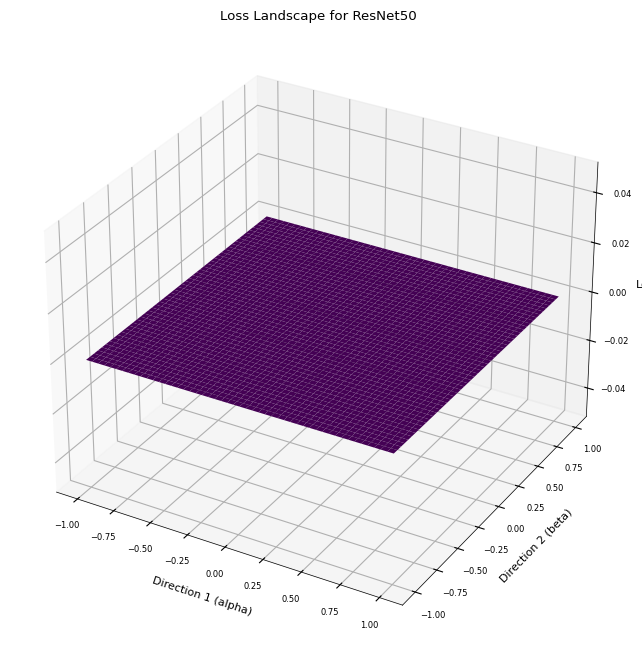

In [12]:
# 8. Restore Original Model Parameters
torch.nn.utils.vector_to_parameters(reference_params, model.parameters())

# 9. Plot the Loss Landscape
X, Y = np.meshgrid(alpha_range, beta_range)
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, loss_values, cmap='viridis')
ax.set_xlabel("Direction 1 (alpha)")
ax.set_ylabel("Direction 2 (beta)")
ax.set_zlabel("Loss")
ax.set_title("Loss Landscape for ResNet50")
plt.show()


## Attention Map

In [97]:
visualizer = AttentionMapVisualizer()

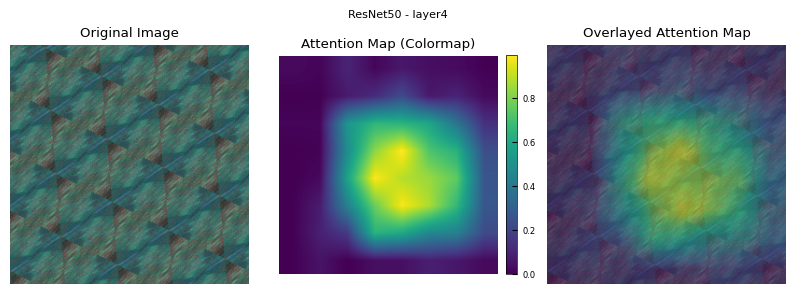

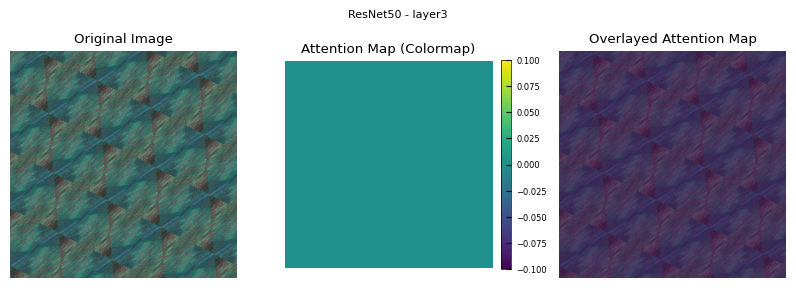

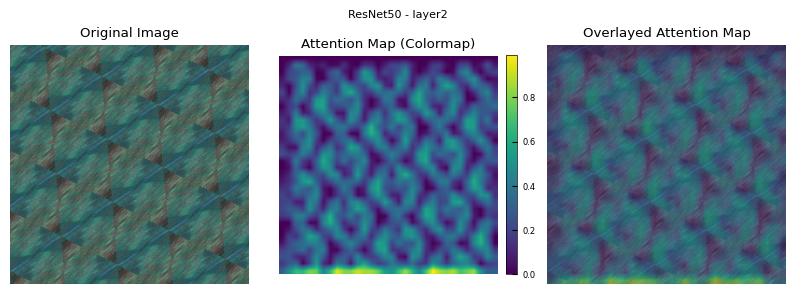

In [ ]:
model = resnet50_(in_channels=3, n_classes=len(symmetry_classes))
model.load_state_dict(torch.load('../../../models/ResNet50/09112024-resnet50-dataset_v5_size-10m/model_epoch_20.pth', weights_only=True))
model.eval()

input_tensor = train_ds[0][0].unsqueeze(0)  # Example input tensor (N, C, H, W)
for i in ['layer4', 'layer3', 'layer2', 'layer1']:
    input_image_np, attention_map_resized = visualizer.generate_cnn_attention_map(model, input_tensor, layer_name=i)
    visualizer.visualize_attention_map(input_image_np, attention_map_resized, title=f"ResNet50 - {i}")

In [ ]:
model = xcit_small(in_channels=3, n_classes=len(symmetry_classes))
model.load_state_dict(torch.load('../../../models/XCiT/09302024-XCiT-dataset_v5_size-10m/model_epoch_20.pth', weights_only=True))
model.eval()
input_tensor = train_ds[1][0].unsqueeze(0)  # Example input tensor (N, C, H, W)

for i in [11, 8, 5, 3, 0]:
    input_image_np, attention_map_resized = visualizer.generate_transformer_attention_map(model, input_tensor, attention_layer_idx=i)
    visualizer.visualize_attention_map(input_image_np, attention_map_resized, title=f"XCiT - attention_layer_idx {i+1}/12")

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 3 dimensions. The detected shape was (2, 256, 256) + inhomogeneous part.

In [96]:
input_image_np.shape

(256, 256, 3)